In [102]:
import os
HOME = os.getcwd()

WEIGHTS_NAME = "groundingdino_swint_ogc.pth"
WEIGHTS_PATH = os.path.join(HOME, WEIGHTS_NAME)
print(WEIGHTS_PATH, "; exist:", os.path.isfile(WEIGHTS_PATH))
CONFIG_PATH = os.path.join(HOME, "GroundingDINO/groundingdino/config/GroundingDINO_SwinT_OGC.py")


/Users/huizhizhang/FISH-ML/groundingdino_swint_ogc.pth ; exist: True


In [103]:
from GroundingDINO.groundingdino.util.inference import load_model, load_image, predict, annotate

model = load_model(CONFIG_PATH, WEIGHTS_PATH)

final text_encoder_type: bert-base-uncased


In [104]:
import supervision as sv
from datasets import Dataset

In [105]:
dataset = Dataset.load_from_disk("./assets/dataset/")
img = dataset[0]["image"]
print(img)

[[113, 130, 106, 119, 112, 112, 103, 112, 120, 118, 119, 119, 112, 118, 106, 131, 121, 109, 114, 104, 115, 118, 104, 106, 119, 113, 123, 125, 106, 113, 120, 129, 107, 112, 116, 108, 112, 128, 131, 105, 115, 115, 114, 122, 113, 116, 114, 117, 105, 106, 117, 112, 102, 115, 131, 116, 122, 124, 105, 116, 119, 109, 118, 130, 112, 114, 115, 114, 119, 123, 121, 112, 120, 126, 119, 126, 106, 116, 108, 115, 116, 142, 123, 126, 116, 119, 119, 122, 119, 119, 130, 109, 125, 123, 109, 127, 127, 118, 118, 123, 117, 103, 113, 121, 114, 112, 112, 105, 135, 119, 120, 127, 112, 109, 130, 118, 121, 126, 107, 106, 126, 106, 116, 120, 114, 117, 115, 114, 119, 120, 125, 120, 122, 129, 122, 106, 119, 113, 110, 130, 120, 112, 112, 109, 116, 115, 110, 112, 114, 115, 109, 125, 120, 110, 110, 128, 121, 106, 109, 114, 115, 109, 109, 112, 149, 110, 112, 121, 111, 119, 120, 116, 120, 126, 127, 114, 119, 116, 124, 113, 116, 107, 115, 118, 109, 121, 109, 117, 128, 110, 126, 120, 118, 112, 129, 127, 107, 119, 120, 128

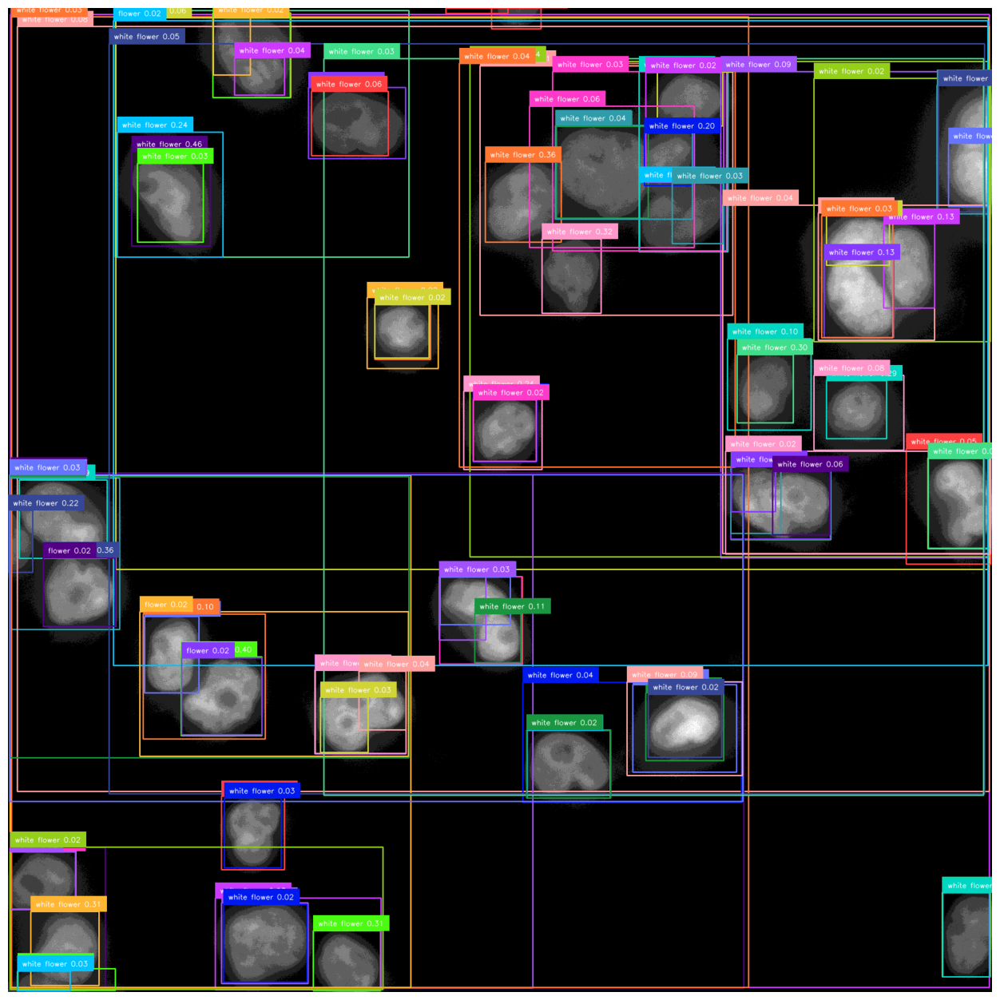

In [114]:
from datasets import Dataset
import numpy as np
import torch
import groundingdino.datasets.transforms as T
from typing import Tuple, List
from PIL import Image
import supervision as sv

def load_image(img: np.ndarray) -> Tuple[np.array, torch.Tensor]:
    def grayscale_to_rgb(grayscale_img) -> np.ndarray:
        rgb_img = np.zeros((2048, 2048, 3), dtype=np.uint8)
        img_uint8 = np.clip(grayscale_img//256, 0, 255).astype(np.uint8)
        rgb_img[:, :, 0] = img_uint8
        rgb_img[:, :, 1] = img_uint8
        rgb_img[:, :, 2] = img_uint8
        dynamic_exp_factor = 255.0 / np.max(rgb_img[:, :, 0])
        brightened_image = np.clip(rgb_img * dynamic_exp_factor, 0, 255).astype(np.uint8)
        return brightened_image
    transform = T.Compose(
        [
            T.RandomResize([800], max_size=1333),
            T.ToTensor(),
            T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
        ]
    )
    image_source = Image.fromarray(grayscale_to_rgb(img))
    image = np.asarray(image_source)
    image_transformed, _ = transform(image_source, None)
    return image, image_transformed



dataset = Dataset.load_from_disk("./assets/dataset/")
img = np.array(dataset[7]["image"])
image_source, image = load_image(img)

TEXT_PROMPT = "white flower"
BOX_TRESHOLD = 0.02
TEXT_TRESHOLD = 0.02

boxes, logits, phrases = predict(
    model=model, 
    image=image, 
    caption=TEXT_PROMPT, 
    box_threshold=BOX_TRESHOLD, 
    text_threshold=TEXT_TRESHOLD,
    device="cpu"
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline 
sv.plot_image(annotated_frame, (16, 16))